<Body>   
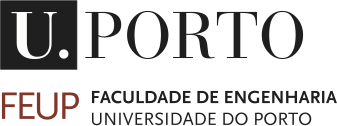   
<h1> <b>Analysis of Complex Data </b> </h1>
</Body>  

<br>**Master in Data Science & Engineering**     <br><br> **Henrique Ribeiro - Ian Karkles - Vitor Pereira**  <br>
<br> Faculty of Engineering, University of Porto <br>FEUP Sep. 2023 

In [53]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import os
from igraph import Graph, plot, RainbowPalette
from functions import *
from surprise import Dataset, Reader, NormalPredictor, KNNBasic, KNNWithZScore, KNNWithMeans, KNNWithZScore, SVD, BaselineOnly
from surprise import SlopeOne, CoClustering, KNNBaseline, SVDpp, NMF
from surprise.model_selection import train_test_split, cross_validate
from collections import defaultdict
from surprise import accuracy

In [ ]:
business = pd.read_csv('dataset/greenwood_business_final.csv')
reviews = pd.read_csv('dataset/greenwood_reviews.csv')
user = pd.read_csv('dataset/greenwood_user_final.csv')
# Remove Unnamed colunm
business = business.loc[:, ~business.columns.str.contains('^Unnamed')]
business = business.drop(columns='stars', axis=1)
reviews = reviews.loc[:, ~reviews.columns.str.contains('^Unnamed')]
reviews = reviews.drop(columns='city', axis=1)
user = user.loc[:, ~user.columns.str.contains('^Unnamed')]

In [2]:
connections = pd.read_csv('dataset/greenwood_connections.csv')
connections.drop('Unnamed: 0', axis=1, inplace=True)

In [3]:
# Choose number of minimum friends required per user: 'thresold'
connections = clean_df(connections, threshold=10)

In [4]:
links, nodes = create_nodes_and_links(connections)

In [5]:
print(f'There are {len(nodes)} nodes')
print(f'There are {len(links[["from","to"]].drop_duplicates())} links')

print(f'\nThere are {len(links)-len(links[["from","to"]].drop_duplicates())} duplication of links within the same two nodes')

There are 6591 nodes
There are 55421 links

There are 0 duplication of links within the same two nodes


# Greenwood data

## Network

In [6]:
# Convert to igraph format
net = Graph.DataFrame(edges=links, directed=True, use_vids=False, vertices=nodes)

In [236]:
layout = net.layout('kk')
print(net)
plot(
    net,
    edge_arrow_size=0,
    vertex_size=5,
    edge_width=0.5,
    vertex_color="blue",  # Set the vertex color to blue
    edge_color="black",
    layout = layout    # Set the edge color to blue
)

IGRAPH DN-- 6591 55421 --
+ attr: name (v), unique_values (v)
+ edges (vertex names):
s01->s3657, s01->s3658, s01->s3659, s01->s3660, s01->s3661, s01->s3662,
s01->s3663, s01->s3664, s01->s3665, s01->s3666, s01->s3667, s01->s3668,
s01->s3669, s01->s3670, s01->s3671, s01->s3672, s01->s3673, s01->s3674,
s01->s3675, s01->s3676, s01->s3677, s01->s3678, s02->s3660, s02->s3664,
s02->s3670, s02->s3679, s02->s3680, s02->s3681, s02->s3682, s02->s3683,
s02->s3684, s02->s3685, s02->s3686, s02->s3687, s02->s3688, s03->s464,
s03->s3660, s03->s3661, s03->s3664, s03->s3670, s03->s3678, s03->s3688,
s03->s3689, s03->s3690, s03->s3691, s03->s3692, s03->s3693, s03->s3694,
s03->s3695, s03->s3696, s04->s3660, s04->s3678, s04->s3697, s04->s3698,
s04->s3699, s05->s3660, s05->s3700, s05->s3701, s05->s3702, s05->s3703,
s06->s3660, s06->s3670, s06->s3672, s06->s3698, s06->s3701, s06->s3704,
s06->s3705, s06->s3706, s06->s3707, s06->s3708, s06->s3709, s06->s3710,
s06->s3711, s06->s3712, s06->s3713, s06->s3714, s06

In [110]:
net_simp = net.simplify(multiple=True, loops=True, combine_edges=dict(weight="sum"))

print(net_simp)
plot(net_simp, edge_arrow_size=0.01, vertex_size=5, edge_width=0)

IGRAPH DN-- 6591 55421 --
+ attr: name (v), unique_values (v)
+ edges (vertex names):
s01->s3657, s01->s3658, s01->s3659, s01->s3660, s01->s3661, s01->s3662,
s01->s3663, s01->s3664, s01->s3665, s01->s3666, s01->s3667, s01->s3668,
s01->s3669, s01->s3670, s01->s3671, s01->s3672, s01->s3673, s01->s3674,
s01->s3675, s01->s3676, s01->s3677, s01->s3678, s02->s3660, s02->s3664,
s02->s3670, s02->s3679, s02->s3680, s02->s3681, s02->s3682, s02->s3683,
s02->s3684, s02->s3685, s02->s3686, s02->s3687, s02->s3688, s03->s464,
s03->s3660, s03->s3661, s03->s3664, s03->s3670, s03->s3678, s03->s3688,
s03->s3689, s03->s3690, s03->s3691, s03->s3692, s03->s3693, s03->s3694,
s03->s3695, s03->s3696, s04->s3660, s04->s3678, s04->s3697, s04->s3698,
s04->s3699, s05->s3660, s05->s3700, s05->s3701, s05->s3702, s05->s3703,
s06->s3660, s06->s3670, s06->s3672, s06->s3698, s06->s3701, s06->s3704,
s06->s3705, s06->s3706, s06->s3707, s06->s3708, s06->s3709, s06->s3710,
s06->s3711, s06->s3712, s06->s3713, s06->s3714, s06

## Network and node characteristics

In [7]:
# Density: The proportion of present edges from all possible edges in the network
edge_density = net.density(loops=False)
print(f"Density: {edge_density:0.4f}")
print(f"or... {net.ecount() / (net.vcount() * (net.vcount() - 1)):0.4f}")

Density: 0.0013
or... 0.0013


In [8]:
# Diameter: longest geodesic distance (eccentricity) between any two vertices in the network
diameter_undirected = net.diameter(directed=False, weights=None)
print(f"Undirected diameter: {diameter_undirected}")
diameter_directed = net.diameter(directed=True, weights=None)
print(f"Directed diameter: {diameter_directed}")
# diameter_weighted = net.diameter(directed=False, weights="weight")
# print(f"Weighted undirected diameter: {diameter_weighted}")

Undirected diameter: 8
Directed diameter: 2


In [9]:
# Remove comment to see the plot

# # Node degrees: how many edges are connected to a node
# # The mode="ALL" parameter means that it calculates the total degree, considering both incoming and outgoing edges for directed graphs
deg = net.degree(mode="ALL")

# # plot the network with node size proportional to degree
# plot(net, vertex_size=[d * 0.1 for d in deg])

### Distribution of degrees

In [12]:
# plt.figure(figsize=(8, 6))


# ax = plt.hist(deg, bins=range(1, max(deg) + 1))
# plt.title("Histogram of node degree")
# plt.show()

### Closeness

In [10]:
# Closeness: proximity of a node to all other nodes in a network.)
# Inverse of the node’s average geodesic distance to others in the network.
# can also be calculated with weights

closeness = net.closeness(mode="ALL", weights=None)

# <node, closeness> pairs
pd.DataFrame({"name": net.vs["name"], "closeness": closeness}).sort_values("closeness", ascending=False)


,name,closeness
3677,s3678,0.435702
251,s252,0.412804
2286,s2287,0.402467
3659,s3660,0.400730
164,s165,0.378409
...,...,...
673,s674,0.193983
2185,s2186,0.192696
3141,s3142,0.192696
2046,s2047,0.189384


### Betweenness

In [11]:
# Betweenness (centrality based on a broker position connecting others) - Number of geodesics that pass through the node or the edge. The higher, the more important the node is.
betweenness = net.betweenness(directed=True, weights=None)
# <node, betweenness> pairs
pd.DataFrame({"name": net.vs["name"], "betweenness": betweenness}).sort_values("betweenness", ascending=False)

,name,betweenness
2286,s2287,136061.0
251,s252,86429.0
463,s464,9334.0
16,s17,3973.0
0,s01,0.0
...,...,...
2196,s2197,0.0
2195,s2196,0.0
2194,s2195,0.0
2193,s2194,0.0


In [12]:
# we can also calculate the betweenness for edges
# measures the importance of edges in facilitating the flow of information between nodes.
edge_betweenness = net.edge_betweenness(directed=True, weights=None)
edge_betweenness

[1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 326.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1012.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1022.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1.0,
 1

In [13]:
# Average path length: the mean of the shortest distance between each pair of nodes in the network (in both directions for directed graphs).
mean_dist_undirected = net.average_path_length(directed=False)
print(f"Average path length (undirected)= {mean_dist_undirected:.3f}")

mean_dist_directed = net.average_path_length(directed=True)
print(f"Average path length (directed)= {mean_dist_directed:.3f}")

Average path length (undirected)= 3.588
Average path length (directed)= 1.810


In [17]:
# There are no categorical variables in our dataset #


# # Calculate assortativity for categorical variables (labels)
# media_type = [v['media.type'] for v in net.vs]
# asso_media_type = net.assortativity_nominal(media_type, directed=False)
# print(f"Assortativity considering media type category= {asso_media_type:.3f}")

# # Calculate assortativity for ordinal and above variables (e.g., audience size)
# audience_size = [v['audience.size'] for v in net.vs]
# asso_audience = net.assortativity(audience_size, directed=False)
# print(f"Assortativity considering audience size = {asso_audience:.3f}")

In [14]:
homophily = net.assortativity_degree(directed=False)

print(f"All network = {homophily:.3f}")

All network = -0.118


As expected, when we are not considering categories, the assortativity is close to zero. A value close to 0 suggests no strong assortativity or disassortativity.

## Plot Visualization

In [19]:
# Remove comment to see the plot
# # Plot with curved edges
# plot(net, edge_arrow_size=0.04, edge_curved=0.1, vertex_size=1)

In [20]:
# Remove comment to see the plot

# # Set edge color to gray, and the node color to orange
# visual_style = {}
# visual_style["vertex_color"] = "orange"
# visual_style["vertex_frame_color"] = "#555555"
# visual_style["vertex_label_color"] = "black"
# visual_style["vertex_label_size"] = 8
# visual_style["edge_arrow_size"] = 0.2
# visual_style["edge_curved"] = 0
# plot(net, **visual_style)

## Hubs and authorities

In [21]:
# There are no categorical variables

# # Calculate hub scores - nodes in a network that point to many other nodes. 
# # They are considered as good sources of information that lead users to relevant content.
# hs = net.hub_score(weights=None)
# plot(net, vertex_size=[hs_i * 50 for hs_i in hs], main="Hubs", vertex_label=net.vs["media"])

## Subgroups and communities

### Cliques

In [15]:
# Make the network undirected and combine edge attributes by summing them
net_sym = net.as_undirected(mode="collapse", combine_edges="sum")

# Cliques - Find cliques (complete subgraphs of an undirected graph)
cliques_list = net_sym.cliques()
clique_sizes = [len(clique) for clique in cliques_list]
largest_cliques_list = [clique for clique in cliques_list if len(clique) == max(clique_sizes)]
vertex_colors = ["grey80"] * net_sym.vcount()
for vertex in largest_cliques_list[0]:
    vertex_colors[vertex] = "gold"

In [23]:
# Remove comment to see the plot

# # Create a graph visualization
# layout = net_sym.layout("fr")  # You can choose a different layout if needed
# plot(net_sym, layout=layout, vertex_color=vertex_colors, vertex_size=1)

### Communities

In [432]:
# Community detection based on edge betweenness (Newman-Girvan)
# High-betweenness edges are removed sequentially (recalculating at each step) and the best partitioning of the network is selected.
communities = net.community_edge_betweenness() 
communities = communities.as_clustering() # just for ease of use

# coloring the nodes based on the community they belong to
num_communities = len(communities)
palette = RainbowPalette(n=num_communities)
for i, community in enumerate(communities):
    net.vs[community]["color"] = i
    community_edges = net.es.select(_within=community)
    community_edges["color"] = i

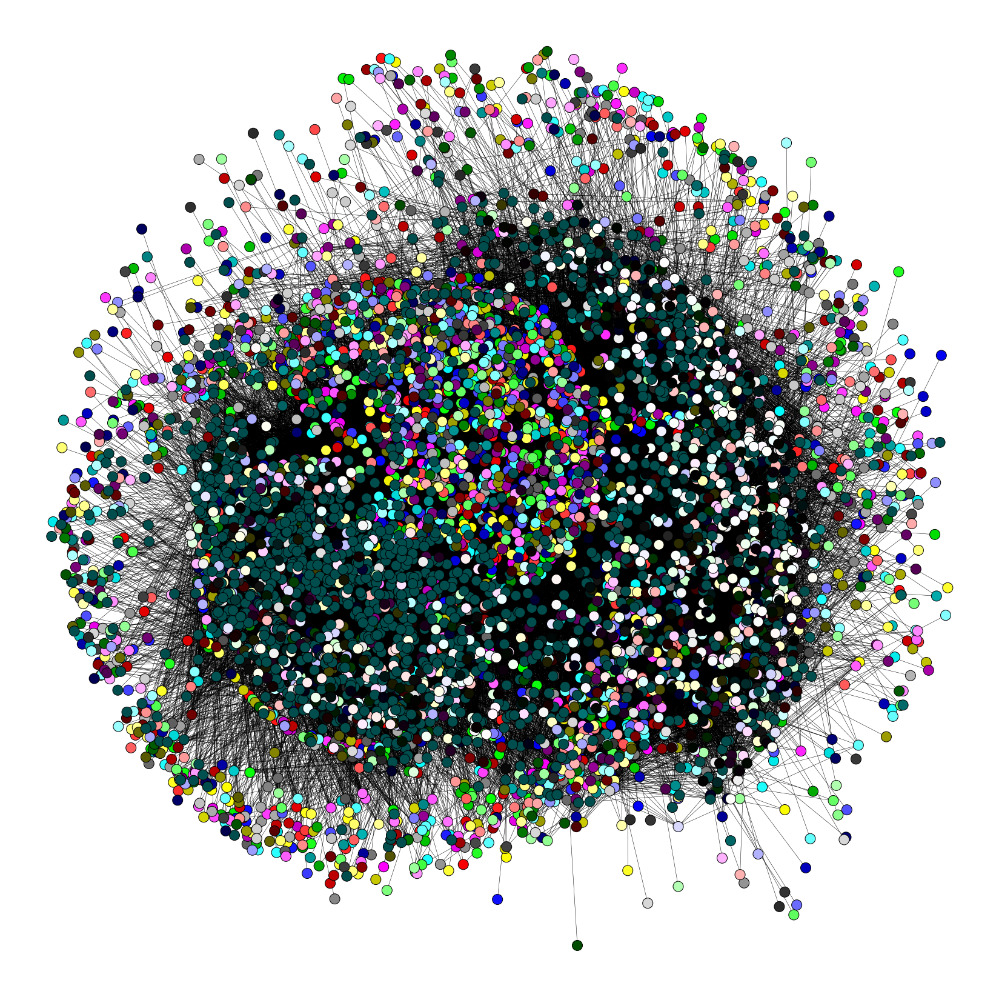

In [18]:
# Set your desired width and height
width = 30
height = 30

fig, ax = plt.subplots(figsize=(width, height))

# Assuming 'communities' is a list that assigns each node to a community
# and 'palette' is a dictionary mapping community IDs to colors

plot(
    communities,
    edge_width=0.5,  # Set edge_width to 0 to remove all edges
    target=ax,
    vertex_size=1,
    layout='kk',
    edge_color='black'
)

# Create a custom color legend
legend_handles = []
for i in range(num_communities):
    handle = ax.scatter(
        [], [],
        s=1,
        facecolor=palette.get(i),  # Use the palette to assign colors
        edgecolor="k",
        label=f'Community {i}',
    )
    legend_handles.append(handle)

plt.show()


##### Closeness

In [433]:
target_color = 3400

for i, community in enumerate(communities):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate edge betweenness for the community subgraph
        close_edge = community_graph.closeness(mode="ALL", weights=None)
        
        # Print the edge betweenness scores for the community
        print(f"Closeness for Community {i}:")
        for edge, close in enumerate(close_edge):
            print(f"Edge {edge}: {close}")

Closeness for Community 3400:
Edge 0: 0.17572425459928104
Edge 1: 0.15289788408463661
Edge 2: 0.15937859608745686
Edge 3: 0.19781004522732681
Edge 4: 0.1877541798463624
Edge 5: 0.24969951923076922
Edge 6: 0.1740678676162547
Edge 7: 0.2238082413143011
Edge 8: 0.24192139737991267
Edge 9: 0.15538519072550486
Edge 10: 0.163873003352396
Edge 11: 0.23661731207289294
Edge 12: 0.24192139737991267
Edge 13: 0.24192139737991267
Edge 14: 0.180299414189629
Edge 15: 0.24192139737991267
Edge 16: 0.24939975990396157
Edge 17: 0.18243688254665202
Edge 18: 0.2548298068077277
Edge 19: 0.2592014971927636
Edge 20: 0.2573552183338495
Edge 21: 0.2430535244223457
Edge 22: 0.24850478468899523
Edge 23: 0.22308724832214766
Edge 24: 0.17472666105971404
Edge 25: 0.18376824413976117
Edge 26: 0.2363481228668942
Edge 27: 0.16278158667972575
Edge 28: 0.1459174714661984
Edge 29: 0.19626830420406235
Edge 30: 0.12236783978795465
Edge 31: 0.15434621099554235
Edge 32: 0.16859403530127814
Edge 33: 0.19258400926998842
Edge 34

##### Betweenness

In [434]:
target_color = 3400

for i, community in enumerate(communities):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate edge betweenness for the community subgraph
        edge_betweenness = community_graph.edge_betweenness(directed=True, weights=None)
        
        # Print the edge betweenness scores for the community
        print(f"Edge betweenness for Community {i}:")
        for edge, betweenness in enumerate(edge_betweenness):
            print(f"Edge {edge}: {betweenness}")

Edge betweenness for Community 3400:
Edge 0: 1.0
Edge 1: 1.0
Edge 2: 1.0
Edge 3: 1.0
Edge 4: 1.0
Edge 5: 1.0
Edge 6: 1.0
Edge 7: 1.0
Edge 8: 1.0
Edge 9: 1.0
Edge 10: 1.0
Edge 11: 1.0
Edge 12: 1.0
Edge 13: 1.0
Edge 14: 1.0
Edge 15: 1.0
Edge 16: 1.0
Edge 17: 1.0
Edge 18: 1.0
Edge 19: 1.0
Edge 20: 1.0
Edge 21: 1.0
Edge 22: 1.0
Edge 23: 1.0
Edge 24: 1.0
Edge 25: 1.0
Edge 26: 1.0
Edge 27: 1.0
Edge 28: 1.0
Edge 29: 1.0
Edge 30: 1.0
Edge 31: 1.0
Edge 32: 1.0
Edge 33: 1.0
Edge 34: 1.0
Edge 35: 1.0
Edge 36: 1.0
Edge 37: 1.0
Edge 38: 1.0
Edge 39: 1.0
Edge 40: 1.0
Edge 41: 1.0
Edge 42: 1.0
Edge 43: 1.0
Edge 44: 1.0
Edge 45: 1.0
Edge 46: 1.0
Edge 47: 1.0
Edge 48: 1.0
Edge 49: 1.0
Edge 50: 1.0
Edge 51: 1.0
Edge 52: 1.0
Edge 53: 1.0
Edge 54: 1.0
Edge 55: 1.0
Edge 56: 1.0
Edge 57: 1.0
Edge 58: 1.0
Edge 59: 1.0
Edge 60: 1.0
Edge 61: 1.0
Edge 62: 1.0
Edge 63: 1.0
Edge 64: 1.0
Edge 65: 1.0
Edge 66: 1.0
Edge 67: 1.0
Edge 68: 1.0
Edge 69: 1.0
Edge 70: 1.0
Edge 71: 1.0
Edge 72: 1.0
Edge 73: 1.0
Edge 74: 1.

##### Assortativity

In [435]:
target_color = 3400

for i, community in enumerate(communities):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate assortativity within the community
        assortativity_score = community_graph.assortativity_degree(directed=False) # Assuming you want to measure assortativity by color attribute
        
        # Print the assortativity score for the community
        print(f"Assortativity for Community {i}: {assortativity_score}")

Assortativity for Community 3400: -0.23314557096976302


### Communities 2

In [436]:
communities_2 = net.community_label_propagation()

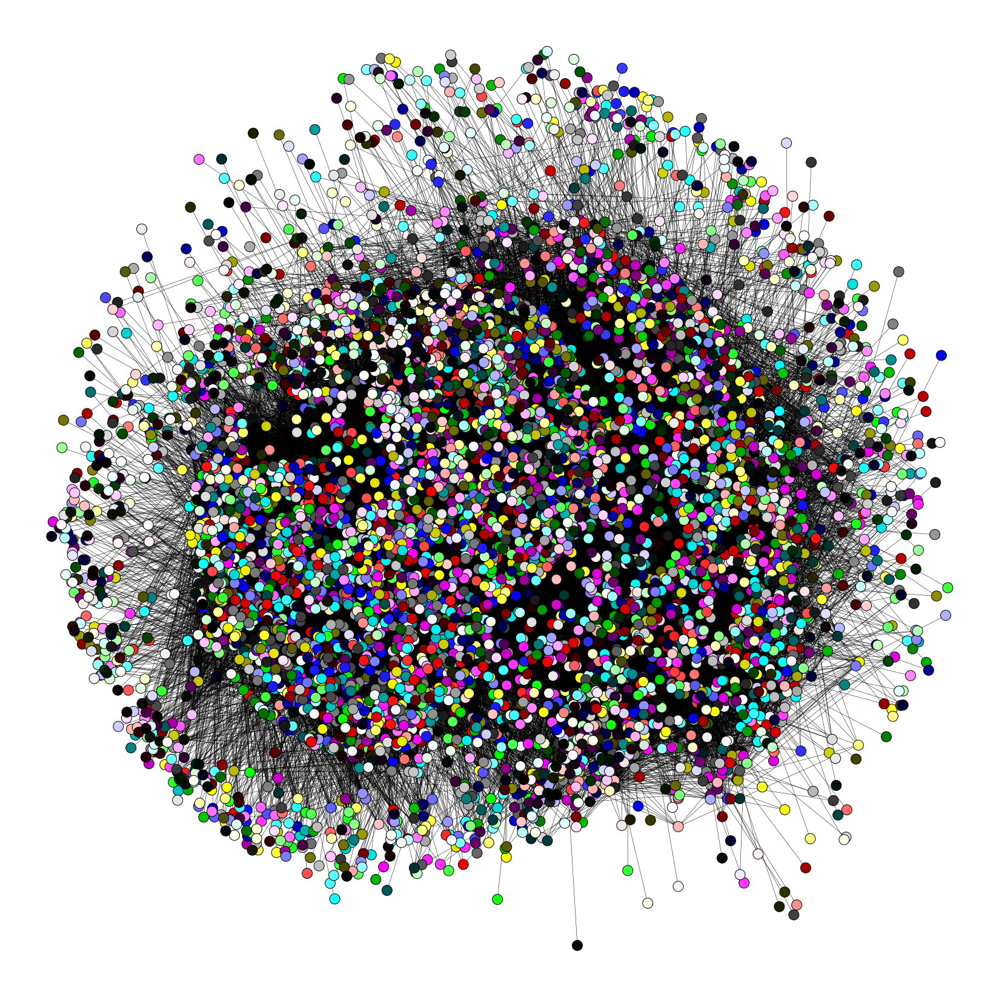

In [156]:
# Set your desired width and height
width = 30
height = 30

fig, ax = plt.subplots(figsize=(width, height))

# Assuming 'communities' is a list that assigns each node to a community
# and 'palette' is a dictionary mapping community IDs to colors

plot(
    communities_2,
    edge_width=0.5,  # Set edge_width to 0 to remove all edges
    target=ax,
    vertex_size=1,
    layout='kk',
    edge_color='black'
)

# Create a custom color legend
legend_handles = []
for i in range(num_communities):
    handle = ax.scatter(
        [], [],
        s=1,
        facecolor=palette.get(i),  # Use the palette to assign colors
        edgecolor="k",
        label=f'Community {i}',
    )
    legend_handles.append(handle)

plt.show()

##### Closeness

In [440]:
target_color = 251

for i, community in enumerate(communities_2):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate edge betweenness for the community subgraph
        close_edge = community_graph.closeness(mode="ALL", weights=None)
        
        # Print the edge betweenness scores for the community
        print(f"Closeness for Community {i}:")
        for edge, close in enumerate(close_edge):
            print(f"Edge {edge}: {close}")

Closeness for Community 251:
Edge 0: 0.9857142857142858
Edge 1: 0.5433070866141733
Edge 2: 0.5073529411764706
Edge 3: 0.5073529411764706
Edge 4: 0.5073529411764706
Edge 5: 0.5
Edge 6: 0.5
Edge 7: 0.5
Edge 8: 0.5
Edge 9: 0.5
Edge 10: 0.5
Edge 11: 0.5073529411764706
Edge 12: 0.5
Edge 13: 0.5
Edge 14: 0.5
Edge 15: 0.5
Edge 16: 0.5073529411764706
Edge 17: 0.5
Edge 18: 0.5073529411764706
Edge 19: 0.5
Edge 20: 0.5
Edge 21: 0.5
Edge 22: 0.5
Edge 23: 0.5
Edge 24: 0.5
Edge 25: 0.5
Edge 26: 0.5
Edge 27: 0.5
Edge 28: 0.5
Edge 29: 0.5
Edge 30: 0.5
Edge 31: 0.5
Edge 32: 0.5
Edge 33: 0.5
Edge 34: 0.5
Edge 35: 0.5
Edge 36: 0.5
Edge 37: 0.5
Edge 38: 0.5
Edge 39: 0.5073529411764706
Edge 40: 0.5
Edge 41: 0.5
Edge 42: 0.5
Edge 43: 0.5073529411764706
Edge 44: 0.5
Edge 45: 0.5
Edge 46: 0.5
Edge 47: 0.5
Edge 48: 0.5
Edge 49: 0.5
Edge 50: 0.5
Edge 51: 0.5
Edge 52: 0.5
Edge 53: 0.5
Edge 54: 0.5
Edge 55: 0.5073529411764706
Edge 56: 0.5
Edge 57: 0.5
Edge 58: 0.5
Edge 59: 0.5
Edge 60: 0.5
Edge 61: 0.5
Edge 62: 0

##### Betweenness

In [441]:
target_color = 251

for i, community in enumerate(communities_2):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate edge betweenness for the community subgraph
        edge_betweenness = community_graph.closeness(mode="ALL", weights=None)
        
        # Print the edge betweenness scores for the community
        print(f"Edge betweenness for Community {i}:")
        for edge, betweenness in enumerate(edge_betweenness):
            print(f"Edge {edge}: {betweenness}")

Edge betweenness for Community 251:
Edge 0: 0.9857142857142858
Edge 1: 0.5433070866141733
Edge 2: 0.5073529411764706
Edge 3: 0.5073529411764706
Edge 4: 0.5073529411764706
Edge 5: 0.5
Edge 6: 0.5
Edge 7: 0.5
Edge 8: 0.5
Edge 9: 0.5
Edge 10: 0.5
Edge 11: 0.5073529411764706
Edge 12: 0.5
Edge 13: 0.5
Edge 14: 0.5
Edge 15: 0.5
Edge 16: 0.5073529411764706
Edge 17: 0.5
Edge 18: 0.5073529411764706
Edge 19: 0.5
Edge 20: 0.5
Edge 21: 0.5
Edge 22: 0.5
Edge 23: 0.5
Edge 24: 0.5
Edge 25: 0.5
Edge 26: 0.5
Edge 27: 0.5
Edge 28: 0.5
Edge 29: 0.5
Edge 30: 0.5
Edge 31: 0.5
Edge 32: 0.5
Edge 33: 0.5
Edge 34: 0.5
Edge 35: 0.5
Edge 36: 0.5
Edge 37: 0.5
Edge 38: 0.5
Edge 39: 0.5073529411764706
Edge 40: 0.5
Edge 41: 0.5
Edge 42: 0.5
Edge 43: 0.5073529411764706
Edge 44: 0.5
Edge 45: 0.5
Edge 46: 0.5
Edge 47: 0.5
Edge 48: 0.5
Edge 49: 0.5
Edge 50: 0.5
Edge 51: 0.5
Edge 52: 0.5
Edge 53: 0.5
Edge 54: 0.5
Edge 55: 0.5073529411764706
Edge 56: 0.5
Edge 57: 0.5
Edge 58: 0.5
Edge 59: 0.5
Edge 60: 0.5
Edge 61: 0.5
Edg

##### Assortativity

In [442]:
target_color = 251

for i, community in enumerate(communities_2):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate assortativity within the community
        assortativity_score = community_graph.assortativity_degree(directed=False) # Assuming you want to measure assortativity by color attribute
        
        # Print the assortativity score for the community
        print(f"Assortativity for Community {i}: {assortativity_score}")

Assortativity for Community 251: -0.8321618772342886


### Communities 3

In [192]:
communities_3 = net.community_walktrap()
communities_3 = communities_3.as_clustering()

In [ ]:
# coloring the nodes based on the community they belong to
num_communities = len(communities_3)
palette = RainbowPalette(n=num_communities)
for i, community in enumerate(communities_3):
    net.vs[community]["color"] = i
    community_edges = net.es.select(_within=community)
    community_edges["color"] = i

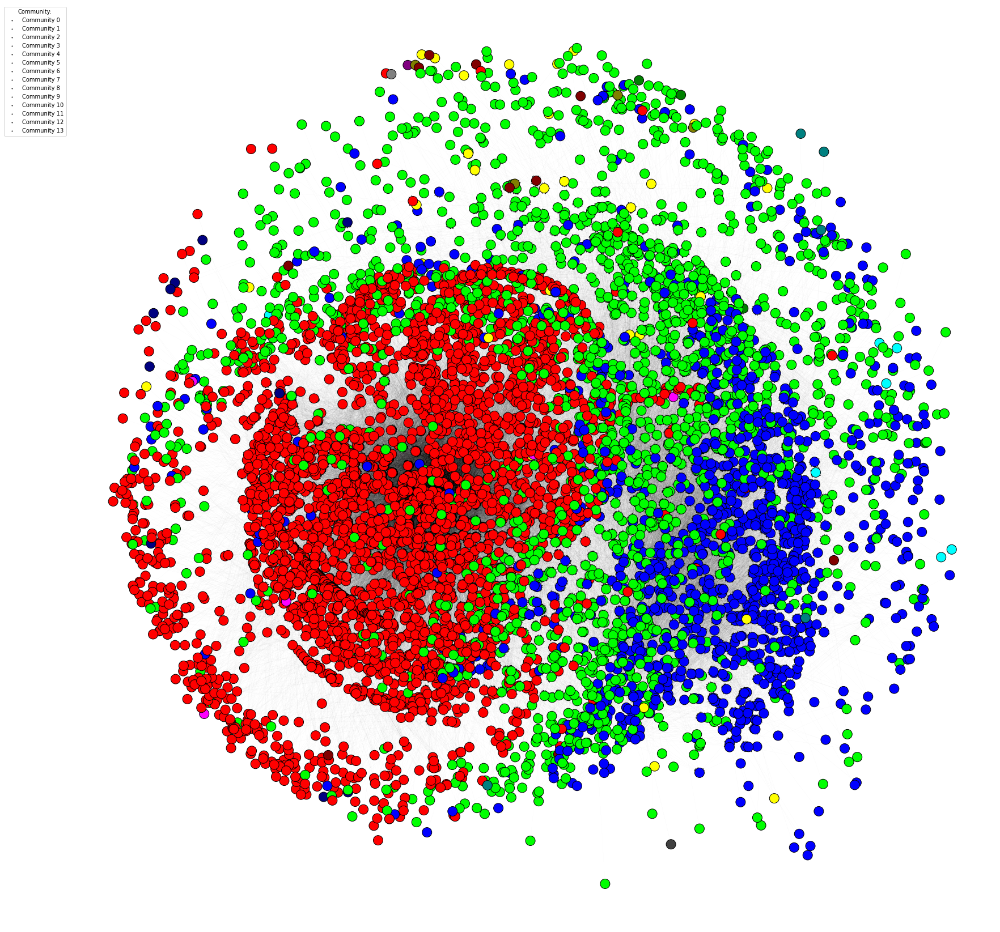

In [228]:
# Set your desired width and height
width = 30
height = 30

fig, ax = plt.subplots(figsize=(width, height))

# Assuming 'communities' is a list that assigns each node to a community
# and 'palette' is a dictionary mapping community IDs to colors

plot(
    communities_3,
    edge_width=0.01,  # Set edge_width to 0 to remove all edges
    target=ax,
    vertex_size=1,
    layout='kk',
    edge_color='black'
)

# Create a custom color legend
legend_handles = []
for i in range(num_communities):
    handle = ax.scatter(
        [], [],
        s=1,
        facecolor=palette.get(i),  # Use the palette to assign colors
        edgecolor="k",
        label=f'Community {i}',
    )
    legend_handles.append(handle)

ax.legend(
    handles=legend_handles,
    title='Community:',
    bbox_to_anchor=(0, 1.0),
    bbox_transform=ax.transAxes,
)

plt.show()

##### Closeness

In [427]:
target_color = 0

for i, community in enumerate(communities_3):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate edge betweenness for the community subgraph
        close_edge = community_graph.closeness(mode="ALL", weights=None)
        
        # Print the edge betweenness scores for the community
        print(f"Closeness for Community {i}:")
        for edge, close in enumerate(close_edge):
            print(f"Edge {edge}: {close}")

Closeness for Community 0:
Edge 0: 0.3625471488795207
Edge 1: 0.3328580158891831
Edge 2: 0.3808413937769491
Edge 3: 0.35533326084592803
Edge 4: 0.32324431256181996
Edge 5: 0.3445076955513388
Edge 6: 0.38048666899522643
Edge 7: 0.34371055952881785
Edge 8: 0.3662855861914369
Edge 9: 0.36114487788705935
Edge 10: 0.362990114406309
Edge 11: 0.41800972115630597
Edge 12: 0.33248550208566485
Edge 13: 0.2929365363929724
Edge 14: 0.34633319203052143
Edge 15: 0.3620250360031018
Edge 16: 0.408704352176088
Edge 17: 0.38456107319369265
Edge 18: 0.3588054457619675
Edge 19: 0.35778410335012045
Edge 20: 0.36567080675842006
Edge 21: 0.3712792547148375
Edge 22: 0.3453815261044177
Edge 23: 0.2782223735739826
Edge 24: 0.3377079673452516
Edge 25: 0.32755337275734187
Edge 26: 0.39873108833577353
Edge 27: 0.3362139917695473
Edge 28: 0.3664498766539583
Edge 29: 0.32732371794871795
Edge 30: 0.363393750694985
Edge 31: 0.2882342564826248
Edge 32: 0.28659124791721474
Edge 33: 0.3715747583854463
Edge 34: 0.35798006

##### Betweenness

In [426]:
target_color = 0

for i, community in enumerate(communities_3):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate edge betweenness for the community subgraph
        edge_betweenness = community_graph.closeness(mode="ALL", weights=None)
        
        # Print the edge betweenness scores for the community
        print(f"Edge betweenness for Community {i}:")
        for edge, betweenness in enumerate(edge_betweenness):
            print(f"Edge {edge}: {betweenness}")
# Iterate through communities and users

Edge betweenness for Community 0:
Edge 0: 0.3625471488795207
Edge 1: 0.3328580158891831
Edge 2: 0.3808413937769491
Edge 3: 0.35533326084592803
Edge 4: 0.32324431256181996
Edge 5: 0.3445076955513388
Edge 6: 0.38048666899522643
Edge 7: 0.34371055952881785
Edge 8: 0.3662855861914369
Edge 9: 0.36114487788705935
Edge 10: 0.362990114406309
Edge 11: 0.41800972115630597
Edge 12: 0.33248550208566485
Edge 13: 0.2929365363929724
Edge 14: 0.34633319203052143
Edge 15: 0.3620250360031018
Edge 16: 0.408704352176088
Edge 17: 0.38456107319369265
Edge 18: 0.3588054457619675
Edge 19: 0.35778410335012045
Edge 20: 0.36567080675842006
Edge 21: 0.3712792547148375
Edge 22: 0.3453815261044177
Edge 23: 0.2782223735739826
Edge 24: 0.3377079673452516
Edge 25: 0.32755337275734187
Edge 26: 0.39873108833577353
Edge 27: 0.3362139917695473
Edge 28: 0.3664498766539583
Edge 29: 0.32732371794871795
Edge 30: 0.363393750694985
Edge 31: 0.2882342564826248
Edge 32: 0.28659124791721474
Edge 33: 0.3715747583854463
Edge 34: 0.3

##### Assortativity

In [429]:
target_color = 0

for i, community in enumerate(communities_3):
    # Get the color of the current community
    community_color = net.vs[community[0]]['color']
    
    # Check if the current community's color matches the target color
    if community_color == target_color:
        # Create a subgraph for the community
        community_graph = net.subgraph(community)
        
        # Calculate assortativity within the community
        assortativity_score = community_graph.assortativity_degree(directed=False) # Assuming you want to measure assortativity by color attribute
        
        # Print the assortativity score for the community
        print(f"Assortativity for Community {i}: {assortativity_score}")

Assortativity for Community 0: -0.1896365068483718


### Recommender System

In [387]:
def get_rs_dataset(communities, users_df, reviews_df, business_df, nodes_df, threshold: int, min_count: int):
    
    communities_df = pd.DataFrame(columns=['community', 'user'])

    # Iterate through communities and users
    for i, community in enumerate(communities):
        users_in_community = [net.vs[v]['name'] for v in community]

        community_df = pd.DataFrame({'community': i, 'user': users_in_community})
        
        communities_df = pd.concat([communities_df, community_df], ignore_index=True)

    # Remove '\n\n' from all values
    communities_df['user'] = communities_df['user'].str.replace('\n\n', '')

    # Reorder columns
    cols = ['user', 'community']
    communities_df = communities_df[cols]

    # Select community with more members than a specific threshold
    # value_counts = communities_df['community'].value_counts()
    # mask = communities_df['community'].map(value_counts) >= threshold
    # communities_df = communities_df[mask].reset_index(drop=True)

    # Merge with nodes
    communities_df = communities_df.merge(nodes_df[['unique_id', 'unique_values']], left_on='user', right_on='unique_id', how='left')
    communities_df.drop(columns=['unique_id'], inplace=True)

    # Merge yelp datasets
    df = pd.merge(reviews_df, users_df, left_on='user_id', right_on='user_id', how='inner')
    df = pd.merge(df, business_df, left_on='business_id', right_on='business_id', how='inner')
    # df = df.drop_duplicates(subset=['user_id', 'business_id'])

    # Remove business that appear less than 'min_count'
    id_counts = df['business_id'].value_counts()
    df = df[df['business_id'].isin(id_counts[id_counts >= min_count].index)]

    #Remove unwanted columns
    cols = ['user_id', 'business_id', 'stars']
    df = df[cols]

    # Merge with yelp's data
    communities_df = communities_df.merge(df[['user_id', 'business_id', 'stars']], left_on='unique_values', right_on='user_id', how='left')
    communities_df = communities_df.dropna()
    communities_df.drop(columns=['unique_values'], inplace=True)

    # Select community with more members than a specific threshold
    value_counts = communities_df['community'].value_counts()
    mask = communities_df['community'].map(value_counts) >= threshold
    communities_df = communities_df[mask].reset_index(drop=True)

    # Create a mapping from the unique values to unique numerical identifiers
    unique_user_ids = communities_df['user_id'].unique()
    unique_business_ids = communities_df['business_id'].unique()

    user_id_to_numeric = {user_id: i + 1 for i, user_id in enumerate(unique_user_ids)}
    business_id_to_numeric = {business_id: i + 1 for i, business_id in enumerate(unique_business_ids)}

    # Create two new columns with unique numerical identifiers
    communities_df['user_numeric_id'] = communities_df['user_id'].map(user_id_to_numeric)
    communities_df['business_numeric_id'] = communities_df['business_id'].map(business_id_to_numeric)

    communities_df = communities_df.reset_index(drop=True)

    
    return communities_df, df

In [162]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module="pandas.core.frame")

In [388]:
results_df = pd.DataFrame(columns=['algorithm','community_id', 'rmse'])

#### Modeling

In [389]:
communities_df, df = get_rs_dataset(communities=communities, users_df=user, reviews_df=reviews,
                                business_df=business, nodes_df=nodes, threshold=5, min_count=5)

In [390]:
communities_df['community'].value_counts()

3400    223
174     131
16      108
18       93
114      73
       ... 
1095      5
195       5
552       5
175       5
767       5
Name: community, Length: 442, dtype: int64

##### KNN Basic

In [391]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = KNNBasic(sim_options={'user_based': True})
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'KNNBasic', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.4083

Community : 2
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.7086

Community : 3
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.6000

Community : 5
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.5831

Community : 6
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.8003

Community : 7
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.4000

Community : 8
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.8373

Community : 9
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.9920

Community : 10
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.2857

Community : 11
Computing the msd similarity matrix...
Done computing similarity matrix.
R

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1312669416.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBasic', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1312669416.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBasic', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1312669416.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBasic', 'community_id': community_id, 'rmse': rmse}, ignore_i


Done computing similarity matrix.
RMSE: 1.5892

Community : 115
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.0138

Community : 121
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 2.5000

Community : 132
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 2.3590

Community : 133
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1673

Community : 135
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.6009

Community : 136
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2583

Community : 137
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.4410

Community : 138
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.0000

Community : 140
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1180

Community : 151
Computin

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1312669416.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBasic', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)



Done computing similarity matrix.
RMSE: 0.8315

Community : 224
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.7500

Community : 226
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.9014

Community : 231
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.5228

Community : 232
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.9903

Community : 235
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 2.0156

Community : 236
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.5831

Community : 239
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.0296

Community : 241
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.5270

Community : 242
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.7071

Community : 243
Computin

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1312669416.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBasic', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### KNN with Means

In [392]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(communities_df[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = KNNWithMeans(sim_options={'user_based': True})
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    #print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'KNN_w/means', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2097

Community : 2
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2310

Community : 3
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2450

Community : 5
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2151

Community : 6
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2267

Community : 7
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2052

Community : 8
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1789

Community : 9
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2049

Community : 10
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1636

Community : 11
Computing the msd similarity matrix...
Done computing similarity matrix.
R

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1538846443.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/means', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1538846443.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/means', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1907

Community : 18
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2185

Community : 19
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2618

Community : 20
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2396

Community : 21
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2173

Community : 22
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2180

Community : 23
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2434

Community : 26
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2846

Community : 27
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2123

Community : 28
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2219

Community : 29
Computing the msd similarity matrix...
Done computing

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1538846443.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/means', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2293

Community : 132
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1900

Community : 133
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2115

Community : 135
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2113

Community : 136
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2626

Community : 137
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2691

Community : 138
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2184

Community : 140
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2475

Community : 151
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1745

Community : 154
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2276

Community : 155
Computing the msd similarity matrix...
Done

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1538846443.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/means', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


Done computing similarity matrix.
RMSE: 1.2354

Community : 184
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2007

Community : 185
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2441

Community : 194
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2046

Community : 195
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2036

Community : 196
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2484

Community : 198
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2233

Community : 200
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2509

Community : 201
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2663

Community : 202
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2640

Community : 203
Computing

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1538846443.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/means', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### KNN Baseline

In [393]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(communities_df[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = KNNBaseline(sim_options={'user_based': True})
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    #print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'KNNBaseline', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1924

Community : 2
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2099

Community : 3
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2398

Community : 5
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2117

Community : 6
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2094

Community : 7
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2287

Community : 8
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1920

Community : 9
Estimating biases using als...
Computing the msd similarity m

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/317339474.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBaseline', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/317339474.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBaseline', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)



Done computing similarity matrix.
RMSE: 1.1977

Community : 20
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2371

Community : 21
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2133

Community : 22
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1901

Community : 23
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2246

Community : 26
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2015

Community : 27
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1997

Community : 28
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2638

Community : 29
Estim

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/317339474.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBaseline', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2075

Community : 132
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1909

Community : 133
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1590

Community : 135
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1879

Community : 136
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2026

Community : 137
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1805

Community : 138
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2420

Community : 140
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2001

Community : 151
Estimating biases using als...
C

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/317339474.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBaseline', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1588

Community : 177
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1940

Community : 181
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1834

Community : 184
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2368

Community : 185
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2224

Community : 194
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2096

Community : 195
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1901

Community : 196
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1885

Community : 198
Estimating biases using als...
C

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/317339474.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBaseline', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### KNN with Z-score

In [394]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(communities_df[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = KNNWithZScore(sim_options={'user_based': True})
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    #print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'KNN_w/zscore', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2818

Community : 2
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1947

Community : 3
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2385

Community : 5
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2355

Community : 6
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2627

Community : 7
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2331

Community : 8
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2235

Community : 9
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2663

Community : 10
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1930

Community : 11
Computing the msd similarity matrix...
Done computing similarity matrix.
R

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3482035255.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/zscore', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2647

Community : 17
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2455

Community : 18
Computing the msd similarity matrix...
Done computing similarity matrix.


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3482035255.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/zscore', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2357

Community : 19
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2577

Community : 20
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1817

Community : 21
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2085

Community : 22
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2962

Community : 23
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2337

Community : 26
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2147

Community : 27
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2483

Community : 28
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2021

Community : 29
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2212

Community : 36
Computing the msd similarity matrix...
Done computing

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3482035255.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/zscore', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2325

Community : 121
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2652

Community : 132
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2430

Community : 133
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1827

Community : 135
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2856

Community : 136
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2511

Community : 137
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2003

Community : 138
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.3062

Community : 140
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2136

Community : 151
Computing the msd similarity matrix...
Done computing similarity matrix.


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3482035255.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/zscore', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.1873

Community : 177
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.3047

Community : 181
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2273

Community : 184
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2964

Community : 185
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2636

Community : 194
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2362

Community : 195
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2295

Community : 196
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2300

Community : 198
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2363

Community : 200
Computing the msd similarity matrix...
Done computing similarity matrix.


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3482035255.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/zscore', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### SVD

In [395]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(communities_df[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = SVD()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    #print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'SVD', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.1212

Community : 2
RMSE: 1.1105

Community : 3
RMSE: 1.1434

Community : 5
RMSE: 1.1642

Community : 6
RMSE: 1.1763

Community : 7
RMSE: 1.1618

Community : 8
RMSE: 1.1186

Community : 9
RMSE: 1.1416

Community : 10
RMSE: 1.1558

Community : 11
RMSE: 1.1104

Community : 13
RMSE: 1.1320

Community : 14
RMSE: 1.1542

Community : 15
RMSE: 1.1227

Community : 16
RMSE: 1.1252

Community : 17


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/73208359.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVD', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/73208359.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVD', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1073

Community : 18
RMSE: 1.1592

Community : 19
RMSE: 1.1598

Community : 20
RMSE: 1.1857

Community : 21
RMSE: 1.1524

Community : 22
RMSE: 1.1985

Community : 23
RMSE: 1.1901

Community : 26
RMSE: 1.1454

Community : 27
RMSE: 1.1463

Community : 28
RMSE: 1.1645

Community : 29
RMSE: 1.1512

Community : 36
RMSE: 1.1033

Community : 38
RMSE: 1.1433

Community : 41
RMSE: 1.1838

Community : 42
RMSE: 1.1490

Community : 44
RMSE: 1.1372

Community : 47
RMSE: 1.1255

Community : 50
RMSE: 1.1657

Community : 51
RMSE: 1.1448

Community : 57
RMSE: 1.1629

Community : 61
RMSE: 1.1486

Community : 62
RMSE: 1.1853

Community : 63
RMSE: 1.1351

Community : 64
RMSE: 1.1148

Community : 67
RMSE: 1.1252

Community : 70
RMSE: 1.0984

Community : 72
RMSE: 1.1174

Community : 73
RMSE: 1.1309

Community : 74
RMSE: 1.1239

Community : 75
RMSE: 1.1754

Community : 78
RMSE: 1.1171

Community : 79
RMSE: 1.1459

Community : 80
RMSE: 1.1380

Community : 82
RMSE: 1.1437

Community : 83
RMSE: 1.1527



/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/73208359.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVD', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1264

Community : 121
RMSE: 1.1406

Community : 132
RMSE: 1.1079

Community : 133
RMSE: 1.0916

Community : 135
RMSE: 1.0982

Community : 136
RMSE: 1.1221

Community : 137
RMSE: 1.1372

Community : 138
RMSE: 1.1704

Community : 140
RMSE: 1.1781

Community : 151
RMSE: 1.1398

Community : 154
RMSE: 1.1559

Community : 155
RMSE: 1.1280

Community : 156
RMSE: 1.1453

Community : 157
RMSE: 1.1733

Community : 158
RMSE: 1.1354

Community : 160
RMSE: 1.1857

Community : 161
RMSE: 1.1679

Community : 163
RMSE: 1.1609

Community : 164
RMSE: 1.1335

Community : 165
RMSE: 1.1453

Community : 169
RMSE: 1.1639

Community : 170
RMSE: 1.1761

Community : 174
RMSE: 1.1203

Community : 175
RMSE: 1.1133

Community : 177
RMSE: 1.1137

Community : 181


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/73208359.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVD', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.0650

Community : 184
RMSE: 1.1426

Community : 185
RMSE: 1.1400

Community : 194
RMSE: 1.1164

Community : 195
RMSE: 1.1208

Community : 196
RMSE: 1.1806

Community : 198
RMSE: 1.1528

Community : 200
RMSE: 1.1376

Community : 201
RMSE: 1.1365

Community : 202
RMSE: 1.1659

Community : 203
RMSE: 1.1361

Community : 205
RMSE: 1.1290

Community : 207
RMSE: 1.1831

Community : 208
RMSE: 1.1071

Community : 210
RMSE: 1.1865

Community : 220
RMSE: 1.1433

Community : 221
RMSE: 1.1396

Community : 223
RMSE: 1.1103

Community : 224
RMSE: 1.1374

Community : 226
RMSE: 1.1206

Community : 231
RMSE: 1.1379

Community : 232
RMSE: 1.1270

Community : 235
RMSE: 1.1475

Community : 236
RMSE: 1.1530

Community : 239
RMSE: 1.1286

Community : 241
RMSE: 1.1390

Community : 242
RMSE: 1.1719

Community : 243
RMSE: 1.1372

Community : 245
RMSE: 1.1382

Community : 247
RMSE: 1.1700

Community : 248
RMSE: 1.1502

Community : 249
RMSE: 1.1341

Community : 251
RMSE: 1.1399

Community : 253
RMSE: 1.15

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/73208359.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVD', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### SVDpp

In [396]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(communities_df[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = SVDpp()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    #print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'SVDpp', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.1249

Community : 2
RMSE: 1.1625

Community : 3
RMSE: 1.1294

Community : 5
RMSE: 1.0920

Community : 6
RMSE: 1.1267

Community : 7
RMSE: 1.1166

Community : 8
RMSE: 1.1184

Community : 9
RMSE: 1.1521

Community : 10
RMSE: 1.1631

Community : 11
RMSE: 1.1439

Community : 13
RMSE: 1.1072

Community : 14
RMSE: 1.1412

Community : 15
RMSE: 1.1058

Community : 16


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/4108646561.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVDpp', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1416

Community : 17


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/4108646561.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVDpp', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1495

Community : 18
RMSE: 1.1423

Community : 19
RMSE: 1.1099

Community : 20
RMSE: 1.1388

Community : 21
RMSE: 1.1649

Community : 22
RMSE: 1.1252

Community : 23
RMSE: 1.1246

Community : 26
RMSE: 1.1324

Community : 27
RMSE: 1.1309

Community : 28
RMSE: 1.1430

Community : 29
RMSE: 1.1185

Community : 36
RMSE: 1.1401

Community : 38
RMSE: 1.1492

Community : 41
RMSE: 1.1956

Community : 42
RMSE: 1.1505

Community : 44
RMSE: 1.1381

Community : 47
RMSE: 1.1528

Community : 50
RMSE: 1.1759

Community : 51
RMSE: 1.1517

Community : 57
RMSE: 1.1543

Community : 61
RMSE: 1.1760

Community : 62
RMSE: 1.1485

Community : 63
RMSE: 1.1435

Community : 64
RMSE: 1.1784

Community : 67
RMSE: 1.1609

Community : 70
RMSE: 1.1556

Community : 72
RMSE: 1.1306

Community : 73
RMSE: 1.1282

Community : 74
RMSE: 1.1170

Community : 75
RMSE: 1.1406

Community : 78
RMSE: 1.1019

Community : 79
RMSE: 1.1549

Community : 80
RMSE: 1.1417

Community : 82
RMSE: 1.1142

Community : 83
RMSE: 1.1888



/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/4108646561.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVDpp', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1229

Community : 115
RMSE: 1.1860

Community : 121
RMSE: 1.1488

Community : 132
RMSE: 1.1550

Community : 133
RMSE: 1.1325

Community : 135
RMSE: 1.1376

Community : 136
RMSE: 1.1575

Community : 137
RMSE: 1.1579

Community : 138
RMSE: 1.1480

Community : 140
RMSE: 1.1229

Community : 151
RMSE: 1.1458

Community : 154
RMSE: 1.1709

Community : 155
RMSE: 1.1428

Community : 156
RMSE: 1.1723

Community : 157
RMSE: 1.1454

Community : 158
RMSE: 1.1726

Community : 160
RMSE: 1.1249

Community : 161
RMSE: 1.1624

Community : 163
RMSE: 1.1256

Community : 164
RMSE: 1.1327

Community : 165
RMSE: 1.1484

Community : 169
RMSE: 1.1755

Community : 170
RMSE: 1.1435

Community : 174


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/4108646561.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVDpp', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1613

Community : 175
RMSE: 1.1294

Community : 177
RMSE: 1.1567

Community : 181
RMSE: 1.1210

Community : 184
RMSE: 1.1248

Community : 185
RMSE: 1.1019

Community : 194
RMSE: 1.1204

Community : 195
RMSE: 1.1557

Community : 196
RMSE: 1.1469

Community : 198
RMSE: 1.1015

Community : 200
RMSE: 1.1503

Community : 201
RMSE: 1.1578

Community : 202
RMSE: 1.1318

Community : 203
RMSE: 1.1873

Community : 205
RMSE: 1.1629

Community : 207
RMSE: 1.1549

Community : 208
RMSE: 1.1273

Community : 210
RMSE: 1.1520

Community : 220
RMSE: 1.1524

Community : 221
RMSE: 1.1289

Community : 223
RMSE: 1.1285

Community : 224
RMSE: 1.1020

Community : 226
RMSE: 1.1350

Community : 231
RMSE: 1.1775

Community : 232
RMSE: 1.1329

Community : 235
RMSE: 1.1305

Community : 236
RMSE: 1.1398

Community : 239
RMSE: 1.1325

Community : 241
RMSE: 1.1451

Community : 242
RMSE: 1.1309

Community : 243
RMSE: 1.1442

Community : 245
RMSE: 1.1593

Community : 247
RMSE: 1.1443

Community : 248
RMSE: 1.16

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/4108646561.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVDpp', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### NMF

In [397]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(communities_df[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = NMF()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    #print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'NMF', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.3024

Community : 2
RMSE: 1.3146

Community : 3
RMSE: 1.3324

Community : 5
RMSE: 1.2738

Community : 6
RMSE: 1.2757

Community : 7
RMSE: 1.2934

Community : 8
RMSE: 1.3211

Community : 9
RMSE: 1.2927

Community : 10
RMSE: 1.3595

Community : 11
RMSE: 1.2824

Community : 13
RMSE: 1.3179

Community : 14
RMSE: 1.2760

Community : 15
RMSE: 1.2943

Community : 16


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3309851080.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'NMF', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.3155

Community : 17
RMSE: 1.2635

Community : 18


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3309851080.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'NMF', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2849

Community : 19
RMSE: 1.2749

Community : 20
RMSE: 1.2565

Community : 21
RMSE: 1.2804

Community : 22
RMSE: 1.3190

Community : 23
RMSE: 1.3292

Community : 26
RMSE: 1.3207

Community : 27
RMSE: 1.2481

Community : 28
RMSE: 1.3195

Community : 29
RMSE: 1.2736

Community : 36
RMSE: 1.2703

Community : 38
RMSE: 1.2890

Community : 41
RMSE: 1.2619

Community : 42
RMSE: 1.3119

Community : 44
RMSE: 1.3037

Community : 47
RMSE: 1.3380

Community : 50
RMSE: 1.2827

Community : 51
RMSE: 1.3086

Community : 57
RMSE: 1.2310

Community : 61
RMSE: 1.2804

Community : 62
RMSE: 1.2712

Community : 63
RMSE: 1.2949

Community : 64
RMSE: 1.2801

Community : 67
RMSE: 1.3049

Community : 70
RMSE: 1.3408

Community : 72
RMSE: 1.3031

Community : 73
RMSE: 1.3140

Community : 74
RMSE: 1.2558

Community : 75
RMSE: 1.3098

Community : 78
RMSE: 1.2397

Community : 79
RMSE: 1.3076

Community : 80
RMSE: 1.3051

Community : 82
RMSE: 1.2702

Community : 83
RMSE: 1.3192

Community : 85
RMSE: 1.2771



/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3309851080.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'NMF', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2696

Community : 115
RMSE: 1.3051

Community : 121
RMSE: 1.3249

Community : 132
RMSE: 1.2778

Community : 133
RMSE: 1.2869

Community : 135
RMSE: 1.3072

Community : 136
RMSE: 1.2646

Community : 137
RMSE: 1.3468

Community : 138
RMSE: 1.2514

Community : 140
RMSE: 1.2317

Community : 151
RMSE: 1.2740

Community : 154
RMSE: 1.2675

Community : 155
RMSE: 1.2583

Community : 156
RMSE: 1.2248

Community : 157
RMSE: 1.2809

Community : 158
RMSE: 1.3008

Community : 160
RMSE: 1.3605

Community : 161
RMSE: 1.2592

Community : 163
RMSE: 1.3032

Community : 164
RMSE: 1.2678

Community : 165
RMSE: 1.2976

Community : 169
RMSE: 1.3510

Community : 170
RMSE: 1.3070

Community : 174
RMSE: 1.3101

Community : 175


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3309851080.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'NMF', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.3063

Community : 177
RMSE: 1.3317

Community : 181
RMSE: 1.3269

Community : 184
RMSE: 1.2661

Community : 185
RMSE: 1.2856

Community : 194
RMSE: 1.3143

Community : 195
RMSE: 1.2521

Community : 196
RMSE: 1.2562

Community : 198
RMSE: 1.2980

Community : 200
RMSE: 1.3226

Community : 201
RMSE: 1.3057

Community : 202
RMSE: 1.3196

Community : 203
RMSE: 1.2594

Community : 205
RMSE: 1.2357

Community : 207
RMSE: 1.3202

Community : 208
RMSE: 1.2925

Community : 210
RMSE: 1.3333

Community : 220
RMSE: 1.2966

Community : 221
RMSE: 1.3324

Community : 223
RMSE: 1.2754

Community : 224
RMSE: 1.3169

Community : 226
RMSE: 1.3233

Community : 231
RMSE: 1.3496

Community : 232
RMSE: 1.3213

Community : 235
RMSE: 1.3318

Community : 236
RMSE: 1.2516

Community : 239
RMSE: 1.2958

Community : 241
RMSE: 1.2940

Community : 242
RMSE: 1.2608

Community : 243
RMSE: 1.2693

Community : 245
RMSE: 1.2804

Community : 247
RMSE: 1.2817

Community : 248
RMSE: 1.3355

Community : 249
RMSE: 1.28

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3309851080.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'NMF', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### SlopeOne

In [398]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(communities_df[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = SlopeOne()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    #print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'SlopeOne', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.2856

Community : 2
RMSE: 1.3068

Community : 3
RMSE: 1.3265

Community : 5
RMSE: 1.2925

Community : 6
RMSE: 1.2348

Community : 7
RMSE: 1.2579

Community : 8
RMSE: 1.2730

Community : 9
RMSE: 1.2900

Community : 10
RMSE: 1.2669

Community : 11
RMSE: 1.2704

Community : 13
RMSE: 1.2605

Community : 14
RMSE: 1.3002

Community : 15
RMSE: 1.2396

Community : 16
RMSE: 1.2738

Community : 17
RMSE: 1.2848

Community : 18
RMSE: 1.3047

Community : 19
RMSE: 1.2520

Community : 20


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1909861.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SlopeOne', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1909861.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SlopeOne', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2537

Community : 21
RMSE: 1.3287

Community : 22
RMSE: 1.2638

Community : 23
RMSE: 1.2762

Community : 26
RMSE: 1.2386

Community : 27
RMSE: 1.2765

Community : 28
RMSE: 1.2836

Community : 29
RMSE: 1.2945

Community : 36
RMSE: 1.2434

Community : 38
RMSE: 1.3425

Community : 41
RMSE: 1.2673

Community : 42
RMSE: 1.2623

Community : 44
RMSE: 1.2542

Community : 47
RMSE: 1.2781

Community : 50
RMSE: 1.3181

Community : 51
RMSE: 1.2965

Community : 57
RMSE: 1.2846

Community : 61
RMSE: 1.2895

Community : 62
RMSE: 1.2449

Community : 63
RMSE: 1.2992

Community : 64
RMSE: 1.3215

Community : 67
RMSE: 1.2963

Community : 70
RMSE: 1.2939

Community : 72
RMSE: 1.2629

Community : 73
RMSE: 1.2835

Community : 74
RMSE: 1.3349

Community : 75
RMSE: 1.2836

Community : 78
RMSE: 1.2833

Community : 79
RMSE: 1.2774

Community : 80
RMSE: 1.2937

Community : 82
RMSE: 1.2679

Community : 83
RMSE: 1.2644

Community : 85
RMSE: 1.2914

Community : 86
RMSE: 1.2526

Community : 87
RMSE: 1.2732



/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1909861.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SlopeOne', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2676

Community : 133
RMSE: 1.2349

Community : 135
RMSE: 1.2110

Community : 136
RMSE: 1.2419

Community : 137
RMSE: 1.2779

Community : 138
RMSE: 1.2602

Community : 140
RMSE: 1.2788

Community : 151
RMSE: 1.2950

Community : 154
RMSE: 1.3164

Community : 155
RMSE: 1.3431

Community : 156
RMSE: 1.3221

Community : 157
RMSE: 1.2490

Community : 158
RMSE: 1.3287

Community : 160
RMSE: 1.2435

Community : 161
RMSE: 1.2776

Community : 163
RMSE: 1.2437

Community : 164
RMSE: 1.2317

Community : 165
RMSE: 1.2655

Community : 169
RMSE: 1.2560

Community : 170
RMSE: 1.2380

Community : 174
RMSE: 1.2449

Community : 175
RMSE: 1.2539

Community : 177
RMSE: 1.2676

Community : 181


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1909861.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SlopeOne', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2681

Community : 184
RMSE: 1.2325

Community : 185
RMSE: 1.2698

Community : 194
RMSE: 1.2766

Community : 195
RMSE: 1.3239

Community : 196
RMSE: 1.2762

Community : 198
RMSE: 1.2570

Community : 200
RMSE: 1.2805

Community : 201
RMSE: 1.2705

Community : 202
RMSE: 1.2793

Community : 203
RMSE: 1.2758

Community : 205
RMSE: 1.2858

Community : 207
RMSE: 1.2441

Community : 208
RMSE: 1.2540

Community : 210
RMSE: 1.2833

Community : 220
RMSE: 1.2542

Community : 221
RMSE: 1.3144

Community : 223
RMSE: 1.2584

Community : 224
RMSE: 1.2682

Community : 226
RMSE: 1.2547

Community : 231
RMSE: 1.2942

Community : 232
RMSE: 1.2953

Community : 235
RMSE: 1.2723

Community : 236
RMSE: 1.3095

Community : 239
RMSE: 1.2751

Community : 241
RMSE: 1.2742

Community : 242
RMSE: 1.3030

Community : 243
RMSE: 1.3122

Community : 245
RMSE: 1.3004

Community : 247
RMSE: 1.2921

Community : 248
RMSE: 1.2952

Community : 249
RMSE: 1.2587

Community : 251
RMSE: 1.2903

Community : 253
RMSE: 1.25

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1909861.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SlopeOne', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### CoClustering

In [399]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df[communities_df['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(communities_df[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = CoClustering()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    #print(predictions)
    if community_id == 16 or community_id == 18 or community_id == 114 or community_id == 174 or community_id == 3400:
        results_df = results_df.append({'algorithm': 'CoClustering', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.2063

Community : 2
RMSE: 1.2007

Community : 3
RMSE: 1.1948

Community : 5
RMSE: 1.2383

Community : 6
RMSE: 1.2625

Community : 7
RMSE: 1.2094

Community : 8
RMSE: 1.2468

Community : 9
RMSE: 1.2109

Community : 10
RMSE: 1.2661

Community : 11
RMSE: 1.2012

Community : 13
RMSE: 1.2791

Community : 14
RMSE: 1.2276

Community : 15
RMSE: 1.2379

Community : 16
RMSE: 1.2216

Community : 17


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2875947462.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'CoClustering', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2124

Community : 18
RMSE: 1.2105

Community : 19


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2875947462.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'CoClustering', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2017

Community : 20
RMSE: 1.2177

Community : 21
RMSE: 1.1919

Community : 22
RMSE: 1.2320

Community : 23
RMSE: 1.2070

Community : 26
RMSE: 1.2338

Community : 27
RMSE: 1.2283

Community : 28
RMSE: 1.2548

Community : 29
RMSE: 1.1934

Community : 36
RMSE: 1.2290

Community : 38
RMSE: 1.1933

Community : 41
RMSE: 1.2159

Community : 42
RMSE: 1.2223

Community : 44
RMSE: 1.2057

Community : 47
RMSE: 1.2702

Community : 50
RMSE: 1.2380

Community : 51
RMSE: 1.1516

Community : 57
RMSE: 1.2255

Community : 61
RMSE: 1.2268

Community : 62
RMSE: 1.2433

Community : 63
RMSE: 1.2294

Community : 64
RMSE: 1.1832

Community : 67
RMSE: 1.2348

Community : 70
RMSE: 1.1883

Community : 72
RMSE: 1.2691

Community : 73
RMSE: 1.2363

Community : 74
RMSE: 1.2371

Community : 75
RMSE: 1.2315

Community : 78
RMSE: 1.2302

Community : 79
RMSE: 1.2079

Community : 80
RMSE: 1.2547

Community : 82
RMSE: 1.1915

Community : 83
RMSE: 1.1828

Community : 85
RMSE: 1.1983

Community : 86
RMSE: 1.2087



/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2875947462.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'CoClustering', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2156

Community : 121
RMSE: 1.2483

Community : 132
RMSE: 1.2532

Community : 133
RMSE: 1.1989

Community : 135
RMSE: 1.2487

Community : 136
RMSE: 1.2208

Community : 137
RMSE: 1.2390

Community : 138
RMSE: 1.1722

Community : 140
RMSE: 1.2643

Community : 151
RMSE: 1.2591

Community : 154
RMSE: 1.2114

Community : 155
RMSE: 1.2719

Community : 156
RMSE: 1.2057

Community : 157
RMSE: 1.2142

Community : 158
RMSE: 1.1928

Community : 160
RMSE: 1.2261

Community : 161
RMSE: 1.1886

Community : 163
RMSE: 1.2204

Community : 164
RMSE: 1.2399

Community : 165
RMSE: 1.2172

Community : 169
RMSE: 1.2675

Community : 170
RMSE: 1.1925

Community : 174


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2875947462.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'CoClustering', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.1956

Community : 175
RMSE: 1.2346

Community : 177
RMSE: 1.2192

Community : 181
RMSE: 1.2257

Community : 184
RMSE: 1.2531

Community : 185
RMSE: 1.2448

Community : 194
RMSE: 1.2196

Community : 195
RMSE: 1.1979

Community : 196
RMSE: 1.2226

Community : 198
RMSE: 1.2336

Community : 200
RMSE: 1.2419

Community : 201
RMSE: 1.2718

Community : 202
RMSE: 1.2220

Community : 203
RMSE: 1.2443

Community : 205
RMSE: 1.1949

Community : 207
RMSE: 1.2095

Community : 208
RMSE: 1.2135

Community : 210
RMSE: 1.2317

Community : 220
RMSE: 1.2338

Community : 221
RMSE: 1.2023

Community : 223
RMSE: 1.1796

Community : 224
RMSE: 1.2185

Community : 226
RMSE: 1.2319

Community : 231
RMSE: 1.1871

Community : 232
RMSE: 1.2269

Community : 235
RMSE: 1.2601

Community : 236
RMSE: 1.2273

Community : 239
RMSE: 1.2556

Community : 241
RMSE: 1.2312

Community : 242
RMSE: 1.2591

Community : 243
RMSE: 1.2517

Community : 245
RMSE: 1.2235

Community : 247
RMSE: 1.2652

Community : 248
RMSE: 1.23

/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2875947462.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'CoClustering', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


In [400]:
results_df

,algorithm,community_id,rmse
0,KNNBasic,16,1.179248
1,KNNBasic,18,0.816497
2,KNNBasic,114,2.174665
3,KNNBasic,174,0.979796
4,KNNBasic,3400,0.500000
5,KNN_w/means,16,1.267879
6,KNN_w/means,18,1.190676
7,KNN_w/means,114,1.218283
8,KNN_w/means,174,1.260803
9,KNN_w/means,3400,1.225618


#### Modeling 2

In [401]:
communities_df_3, df = get_rs_dataset(communities=communities_3, users_df=user, reviews_df=reviews,
                                business_df=business, nodes_df=nodes, threshold=41, min_count=5)

In [402]:
communities_df_3['community'].value_counts()

0    6602
1    2403
2     932
Name: community, dtype: int64

##### KNN Basic

In [453]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = KNNBasic(sim_options={'user_based': True})
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    # if community_id == 0 or community_id == 1 or community_id == 2:
    #     results_df = results_df.append({'algorithm': 'KNNBasic_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2203

Community : 1
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.6207

Community : 2
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.6601


##### KNN with Means

In [404]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = KNNWithMeans(sim_options={'user_based': True})
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 0 or community_id == 1 or community_id == 2:
        results_df = results_df.append({'algorithm': 'KNN_w/means_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2724

Community : 1
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.6425

Community : 2
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.6710


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2096410994.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/means_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2096410994.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/means_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2096410994.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/means_3', 'community_id': community_id, 'rmse': 

##### KNN Baseline

In [405]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = KNNBaseline(sim_options={'user_based': True})
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 0 or community_id == 1 or community_id == 2:
        results_df = results_df.append({'algorithm': 'KNNBaseline_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2007

Community : 1
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.5763

Community : 2
Estimating biases using als...
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.5354


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1218646513.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBaseline_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1218646513.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBaseline_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/1218646513.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNNBaseline_3', 'community_id': community_id, 'rmse': 

##### KNN with Z-score

In [406]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = KNNWithZScore(sim_options={'user_based': True})
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 0 or community_id == 1 or community_id == 2:
        results_df = results_df.append({'algorithm': 'KNN_w/zscore_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.2607

Community : 1
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.6739

Community : 2
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.6310


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3433833270.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/zscore_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3433833270.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/zscore_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3433833270.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'KNN_w/zscore_3', 'community_id': community_id, 'rmse

##### SVD

In [407]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = SVD()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 0 or community_id == 1 or community_id == 2:
        results_df = results_df.append({'algorithm': 'SVD_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.1442

Community : 1
RMSE: 1.5338

Community : 2
RMSE: 1.5741


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/513130100.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVD_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/513130100.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVD_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/513130100.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVD_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


##### SVDpp

In [408]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = SVDpp()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 0 or community_id == 1 or community_id == 2:
        results_df = results_df.append({'algorithm': 'SVDpp_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.1112

Community : 1
RMSE: 1.5256

Community : 2
RMSE: 1.4832


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/323632543.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVDpp_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/323632543.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVDpp_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/323632543.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SVDpp_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=T

##### NMF

In [409]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = NMF()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 0 or community_id == 1 or community_id == 2:
        results_df = results_df.append({'algorithm': 'NMF_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.3324

Community : 1
RMSE: 1.6810

Community : 2
RMSE: 1.7037


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3474977510.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'NMF_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3474977510.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'NMF_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/3474977510.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'NMF_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True

##### SlopeOne

In [410]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = SlopeOne()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 0 or community_id == 1 or community_id == 2:
        results_df = results_df.append({'algorithm': 'SlopeOne_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0
RMSE: 1.3525

Community : 1
RMSE: 1.7437

Community : 2
RMSE: 1.6274


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2737112945.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SlopeOne_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2737112945.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SlopeOne_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/2737112945.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'SlopeOne_3', 'community_id': community_id, 'rmse': rmse}, ig

##### CoClustering

In [411]:
community_recommender_systems = {}
reader = Reader(rating_scale=(df.stars.min(), df.stars.max()))  # Define a rating scale

for community_id in communities_df_3['community'].unique():
    # Create a subset of users_df for the current community
    community_data = communities_df_3[communities_df_3['community'] == community_id]

    print('\nCommunity :', community_id)

    # Load data into the Surprise dataset
    data = Dataset.load_from_df(community_data[['user_numeric_id', 'business_numeric_id', 'stars']], reader)

    # Split data into train and test sets
    trainset, testset = train_test_split(data, test_size=0.2)
    
    # Build and train a recommender system for this community
    recommender = CoClustering()
    recommender.fit(trainset)
    predictions = recommender.test(testset)
    # print(predictions)
    if community_id == 0 or community_id == 1 or community_id == 2:
        results_df = results_df.append({'algorithm': 'CoClustering_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
    # Compute and return RMSE
    rmse = accuracy.rmse(predictions)
    #print(rmse)

    # Store the recommender system for this community
    community_recommender_systems[community_id] = recommender


Community : 0


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/908349691.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'CoClustering_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)
/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/908349691.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'CoClustering_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


RMSE: 1.2070

Community : 1
RMSE: 1.6676

Community : 2
RMSE: 1.6842


/var/folders/41/p5vf899j42g1p4zhnsdw68d40000gn/T/ipykernel_813/908349691.py:22: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'algorithm': 'CoClustering_3', 'community_id': community_id, 'rmse': rmse}, ignore_index=True)


In [446]:
pd.set_option('display.max_rows', None)

In [447]:
results_df

,algorithm,community_id,rmse
0,KNNBasic,16,1.179248
1,KNNBasic,18,0.816497
2,KNNBasic,114,2.174665
3,KNNBasic,174,0.979796
4,KNNBasic,3400,0.500000
5,KNN_w/means,16,1.267879
6,KNN_w/means,18,1.190676
7,KNN_w/means,114,1.218283
8,KNN_w/means,174,1.260803
9,KNN_w/means,3400,1.225618


#### User recommendations

In [455]:
#user_id = 1  # Get the user ID
user_community = communities_df_3.loc[communities_df_3['user_numeric_id'] == 1, 'community'].values[0]

# Use the recommender system corresponding to the user's community
user_recommender = community_recommender_systems[user_community]

# Get recommendations for the user
user_recommendations = user_recommender.get_neighbors(1, k=5)

In [457]:
print("Recommendations for user 1, Community 2: ", user_recommendations)

Recommendations for user 1, Community 2:  [10, 17, 84, 112, 163]
